In [1]:
# Mount google drive 
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [2]:
import shutil


In [3]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!git reset --hard 886f1c03d839575afecb059accf74296fad395b6

Cloning into 'yolov5'...
remote: Enumerating objects: 15067, done.
remote: Counting objects: 100% (106/106), done.
remote: Compressing objects: 100% (52/52), done.
remote: Total 15067 (delta 68), reused 82 (delta 54), pack-reused 14961
Receiving objects: 100% (15067/15067), 13.71 MiB | 8.00 MiB/s, done.
Resolving deltas: 100% (10413/10413), done.
/content/yolov5
HEAD is now at 886f1c0 DDP after autoanchor reorder (#2421)


In [4]:
!git pull

Updating 886f1c0..e40662f
Fast-forward
 .dockerignore                                      |   14 +-
 .github/CODE_OF_CONDUCT.md                         |  128 ++
 .github/ISSUE_TEMPLATE/bug-report.md               |   55 -
 .github/ISSUE_TEMPLATE/bug-report.yml              |   85 ++
 .github/ISSUE_TEMPLATE/config.yml                  |    8 +
 .github/ISSUE_TEMPLATE/feature-request.md          |   27 -
 .github/ISSUE_TEMPLATE/feature-request.yml         |   50 +
 .github/ISSUE_TEMPLATE/question.md                 |   13 -
 .github/ISSUE_TEMPLATE/question.yml                |   33 +
 .github/PULL_REQUEST_TEMPLATE.md                   |    9 +
 .github/README_cn.md                               |  344 +++++
 .github/SECURITY.md                                |    7 +
 .github/dependabot.yml                             |   31 +-
 .github/workflows/ci-testing.yml                   |  193 ++-
 .github/workflows/codeql-analysis.yml              |   66 +-
 .github/workflows/docker.yml      

In [5]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     |████████████████████████████████| 1.6 MB 14.5 MB/s 
Setup complete. Using torch 1.12.1+cu113 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15109MB, multi_processor_count=40)


In [6]:

pip install -r requirements.txt

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [7]:
!unzip -u "/content/drive/MyDrive/Colab Notebooks/IDS 576 Deep Learning/DataSets/Final_combined_Dataset/DataSet.zip" -d "/content/sample_data/Dataset"

Streaming output truncated to the last 5000 lines.
  inflating: /content/sample_data/Dataset/Labels_train/img--110-_jpeg.rf.22f87572aa4425eea43b1347aa518676.txt  
  inflating: /content/sample_data/Dataset/Labels_train/img--110-_jpeg.rf.2e56287721f734873bed5f0e372eb2e4.txt  
  inflating: /content/sample_data/Dataset/Labels_train/img--110-_jpeg.rf.b77bffadd47111e05444ba6b231bcf31.txt  
  inflating: /content/sample_data/Dataset/Labels_train/img--111-_jpeg.rf.350311ea28e2dd163babba90eba6ea75.txt  
  inflating: /content/sample_data/Dataset/Labels_train/img--111-_jpeg.rf.5274bf257e98b806d00fe1ebf0b07643.txt  
  inflating: /content/sample_data/Dataset/Labels_train/img--111-_jpeg.rf.9387c57e545f6ed4d76375323f616566.txt  
  inflating: /content/sample_data/Dataset/Labels_train/img--112-_jpeg.rf.d9e896d150ca2be0b5ad1387a8ace85b.txt  
  inflating: /content/sample_data/Dataset/Labels_train/img--112-_jpeg.rf.ec94f8fde85cd1d0ad7ffc3febff684b.txt  
  inflating: /content/sample_data/Dataset/Labels_trai

In [8]:
import os

path = "/content/sample_data/train"
os.mkdir(path)

In [9]:
path1 = "/content/sample_data/valid"
os.mkdir(path1)

In [10]:
shutil.move("/content/sample_data/Dataset/Images_train", "/content/sample_data/train")
shutil.move("/content/sample_data/Dataset/Labels_train", "/content/sample_data/train")


'/content/sample_data/train/Labels_train'

In [11]:
shutil.move("/content/sample_data/Dataset/Images_val", "/content/sample_data/valid")
shutil.move("/content/sample_data/Dataset/Labels_val", "/content/sample_data/valid")


'/content/sample_data/valid/Labels_val'

In [12]:
import os
src = "/content/sample_data/train/Images_train"   #find out the file name which u want to rename using indexing
dst ="/content/sample_data/train/images"        #change it to the destination name
os.rename(src, dst)

src1 = "/content/sample_data/train/Labels_train"   #find out the file name which u want to rename using indexing
dst1 ="/content/sample_data/train/labels"        #change it to the destination name
os.rename(src1, dst1)


In [13]:
src3 = "/content/sample_data/valid/Images_val"   #find out the file name which u want to rename using indexing
dst3 ="/content/sample_data/valid/images"        #change it to the destination name
os.rename(src3, dst3)

src4 = "/content/sample_data/valid/Labels_val"   #find out the file name which u want to rename using indexing
dst4 ="/content/sample_data/valid/labels"        #change it to the destination name
os.rename(src4, dst4)

In [14]:
# %cd /content/yolov5/
# !python train.py --img 416 --batch 16 --epochs 300 --data '../data.yaml' --cfg ../mask_yolov5s.yaml --weights '' --name mask_yolov5s_results --nosave --cache


In [14]:
number_of_images = len(os.listdir('../sample_data/train/images'))
print(f'Total number of images in train ) {number_of_images}')

number_of_images1 = len(os.listdir('../sample_data/valid/images'))
print(f'Total number of labels in validation) {number_of_images1}')

Total number of images in train ) 12883
Total number of labels in validation) 578


In [16]:
!python train.py --batch 32 --epochs 10 --data plate.yaml --weights yolov5s.pt --freeze 3


train: weights=yolov5s.pt, cfg=, data=plate.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=10, batch_size=32, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[3], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: up to date with https://github.com/ultralytics/yolov5 ✅
YOLOv5 🚀 v6.2-246-ge40662f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_pw=1.0, obj=1.0, obj_pw=1.0, iou_t=0.2, anchor_t=4.0, fl_gamma=0.0, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, d

In [ ]:
# !python train.py --img 640 --batch 32 --epochs 3 --data plate.yaml --weights yolov5s.pt


In [17]:
%ls runs/train/exp/weights/

best.pt  last.pt


[Errno 2] No such file or directory: 'yolov5/'
/content/yolov5


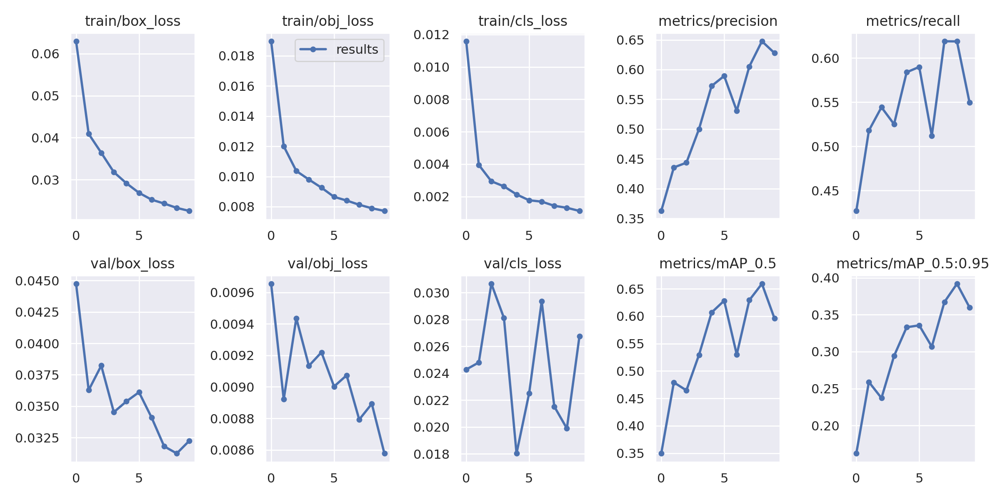

In [18]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
%cd yolov5/
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/exp/results.png', width=1000)  # view results.png

In [ ]:
## inference or detection on new images
!python detect.py --source /content/drive/MyDrive/face_mask_detection/face_data/test --weights /content/yolov5/runs/train/exp2/weights/last.pt --img 416 --conf 0.4 --save-txt --save-conf


detect: weights=['/content/yolov5/runs/train/exp2/weights/last.pt'], source=/content/drive/MyDrive/face_mask_detection/face_data/test, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=True, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
Traceback (most recent call last):
  File "detect.py", line 258, in <module>
    main(opt)
  File "detect.py", line 253, in main
    run(**vars(opt))
  File "/usr/local/lib/python3.7/dist-packages/torch/autograd/grad_mode.py", line 27, in decorate_context
    return func(*args, **kwargs)
  Fil

GROUND TRUTH TRAINING DATA:


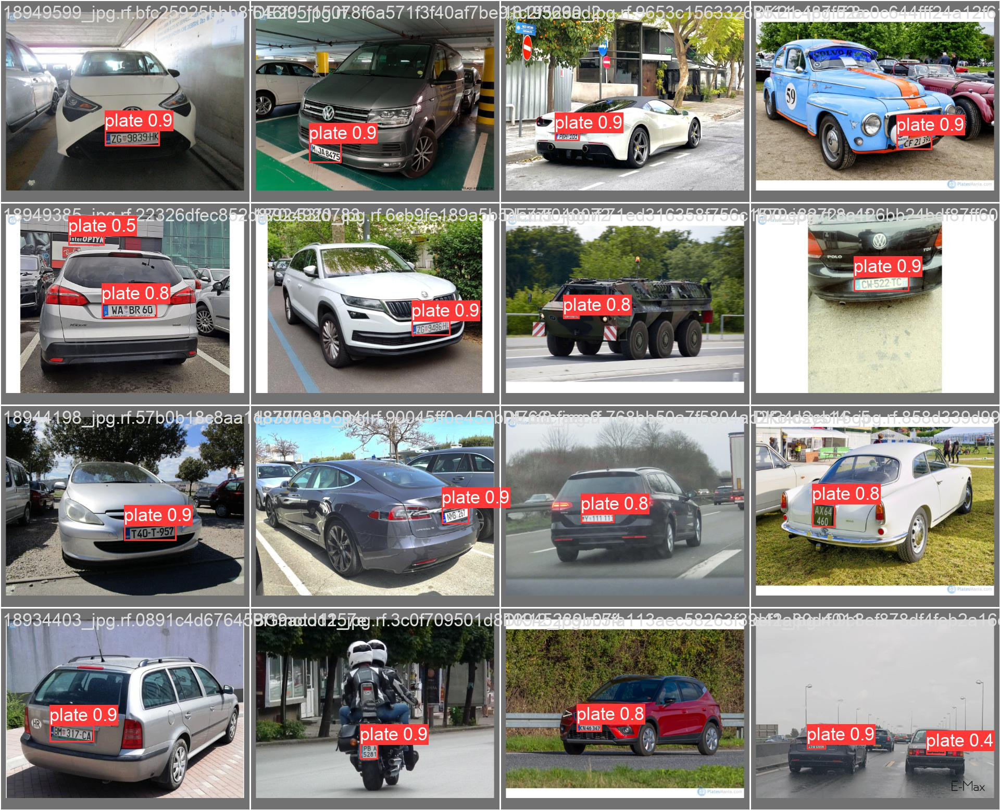

In [19]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/exp/val_batch2_pred.jpg', width=900)

In [ ]:
#Run Inference With Trained Weights

In [20]:
path2 = "/content/sample_data/test"
os.mkdir(path2)

In [21]:
shutil.move("/content/sample_data/Dataset/Images_test", "/content/sample_data/test")
shutil.move("/content/sample_data/Dataset/Labels_test", "/content/sample_data/test")

'/content/sample_data/test/Labels_test'

In [22]:
src5 = "/content/sample_data/test/Images_test"   #find out the file name which u want to rename using indexing
dst5 ="/content/sample_data/test/images"        #change it to the destination name
os.rename(src5, dst5)

src6 = "/content/sample_data/test/Labels_test"   #find out the file name which u want to rename using indexing
dst6 ="/content/sample_data/test/labels"        #change it to the destination name
os.rename(src6, dst6)

In [24]:
!# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights /content/yolov5/runs/train/exp/weights/best.pt --img 416 --conf 0.4 --source ../sample_data/test/images

/content/yolov5
detect: weights=['/content/yolov5/runs/train/exp/weights/best.pt'], source=../sample_data/test/images, data=data/coco128.yaml, imgsz=[416, 416], conf_thres=0.4, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-246-ge40662f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
Model summary: 157 layers, 7015519 parameters, 0 gradients, 15.8 GFLOPs
image 1/206 /content/sample_data/test/images/1--10-_jpg.rf.01a5425f8eec8cd0f22ae747ff474642.jpg: 416x416 1 plate, 14.5ms
image 2/206 /content/sample_data/test/images/1--108-_jpeg.rf.48451eee1d7c8448cf697b1b44e3d0cc.jpg: 416x416 1 plate, 15.6ms
image 3/206 /content/sample_data/test/images/1--110-_jpeg.rf.1dd

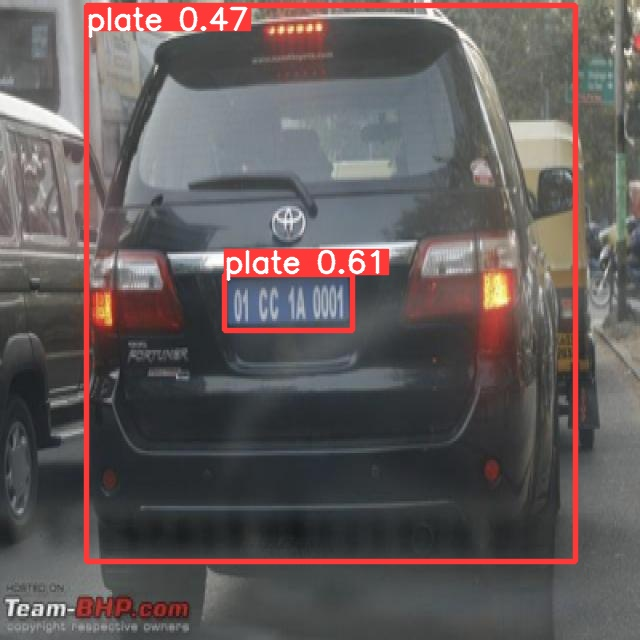

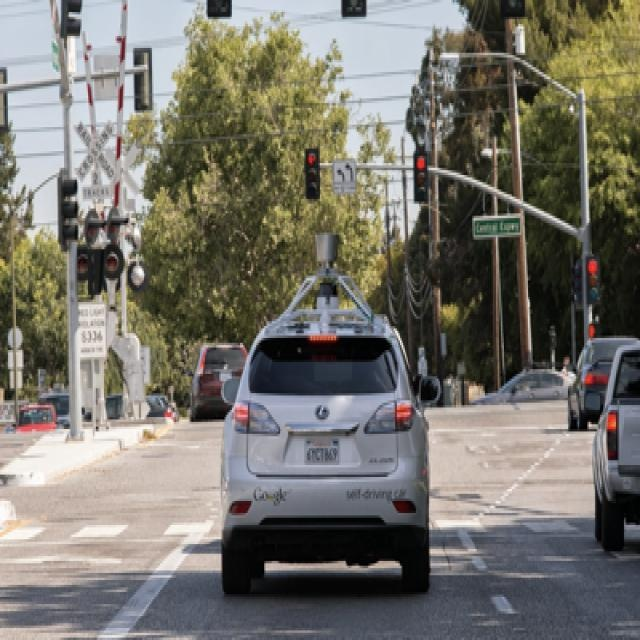

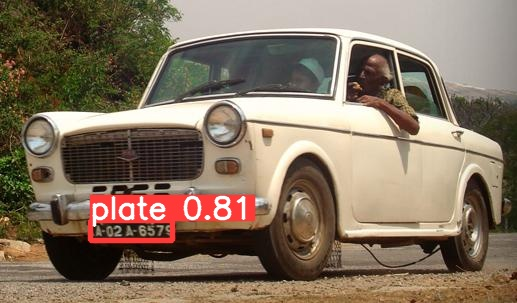

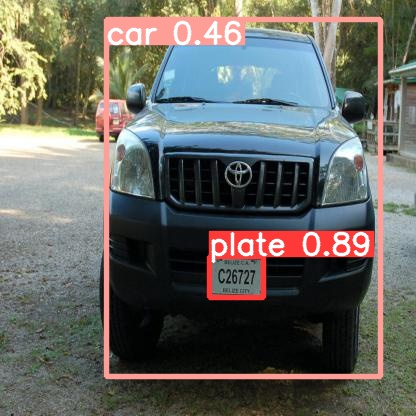

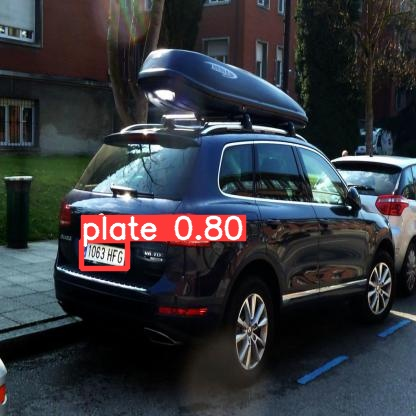

...

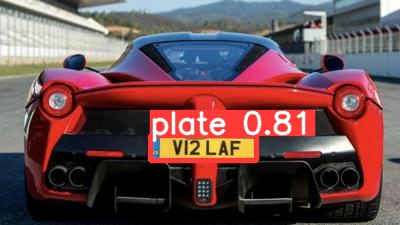

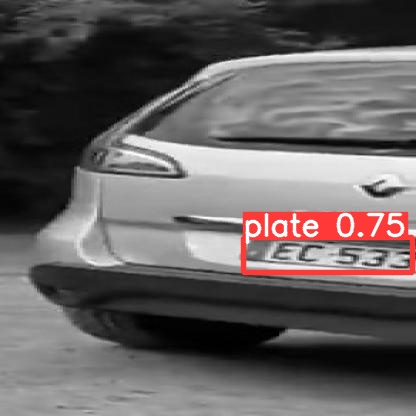

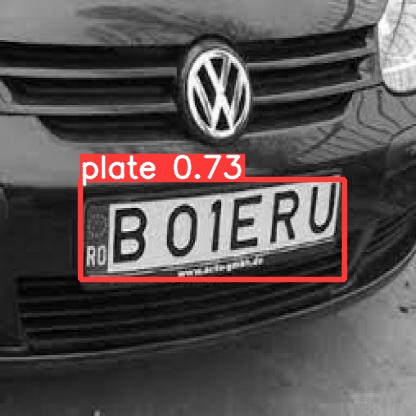

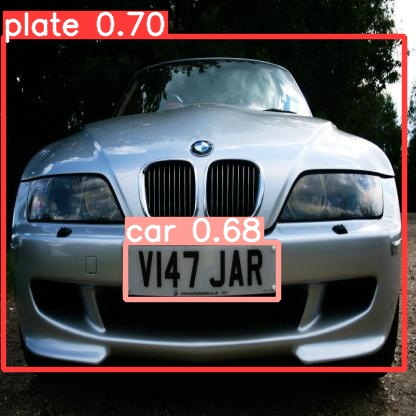

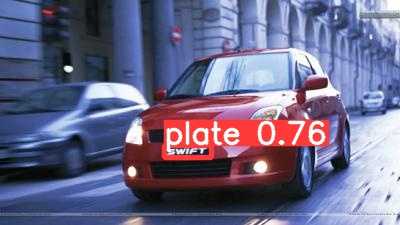

In [25]:
#display result images
import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp2/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")